#### ABOUT
The dataset used below is taken from 'www.kaggle.com'. It consists of information about the various TV shows and Movies that are available on Netflix.


#### IMPORT THE RELEVANT LIBRARIES

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

##### LOAD THE DATASET
Display all the rows and columns of the dataset

In [2]:
data=pd.read_csv('netflix_titles.csv')

In [3]:
pd.options.display.max_columns=None
pd.options.display.max_rows=None
display(data)

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,TV Show,3%,NaN,"João Miguel, Bianca Comparato, Michel Gomes, R...",Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,s2,Movie,7:19,Jorge Michel Grau,"Demián Bichir, Héctor Bonilla, Oscar Serrano, ...",Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,s3,Movie,23:59,Gilbert Chan,"Tedd Chan, Stella Chung, Henley Hii, Lawrence ...",Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,s4,Movie,9,Shane Acker,"Elijah Wood, John C. Reilly, Jennifer Connelly...",United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,s5,Movie,21,Robert Luketic,"Jim Sturgess, Kevin Spacey, Kate Bosworth, Aar...",United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...
5,s6,TV Show,46,Serdar Akar,"Erdal Beşikçioğlu, Yasemin Allen, Melis Birkan...",Turkey,"July 1, 2017",2016,TV-MA,1 Season,"International TV Shows, TV Dramas, TV Mysteries",A genetics professor experiments with a treatm...
6,s7,Movie,122,Yasir Al Yasiri,"Amina Khalil, Ahmed Dawood, Tarek Lotfy, Ahmed...",Egypt,"June 1, 2020",2019,TV-MA,95 min,"Horror Movies, International Movies","After an awful accident, a couple admitted to ..."
7,s8,Movie,187,Kevin Reynolds,"Samuel L. Jackson, John Heard, Kelly Rowan, Cl...",United States,"November 1, 2019",1997,R,119 min,Dramas,After one of his high school students attacks ...
8,s9,Movie,706,Shravan Kumar,"Divya Dutta, Atul Kulkarni, Mohan Agashe, Anup...",India,"April 1, 2019",2019,TV-14,118 min,"Horror Movies, International Movies","When a doctor goes missing, his psychiatrist w..."
9,s10,Movie,1920,Vikram Bhatt,"Rajneesh Duggal, Adah Sharma, Indraneil Sengup...",India,"December 15, 2017",2008,TV-MA,143 min,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...


In [4]:
data.columns.values

array(['show_id', 'type', 'title', 'director', 'cast', 'country',
       'date_added', 'release_year', 'rating', 'duration', 'listed_in',
       'description'], dtype=object)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7787 entries, 0 to 7786
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   show_id       7787 non-null   object
 1   type          7787 non-null   object
 2   title         7787 non-null   object
 3   director      5398 non-null   object
 4   cast          7069 non-null   object
 5   country       7280 non-null   object
 6   date_added    7777 non-null   object
 7   release_year  7787 non-null   int64 
 8   rating        7780 non-null   object
 9   duration      7787 non-null   object
 10  listed_in     7787 non-null   object
 11  description   7787 non-null   object
dtypes: int64(1), object(11)
memory usage: 730.2+ KB


In [6]:
data.describe()

,release_year
count,7787.000000
mean,2013.932580
std,8.757395
min,1925.000000
25%,2013.000000
50%,2017.000000
75%,2018.000000
max,2021.000000


###### Import 'missingno' so as to have a record of all the missing values in the dataset

In [7]:
import missingno as msno

<AxesSubplot:>

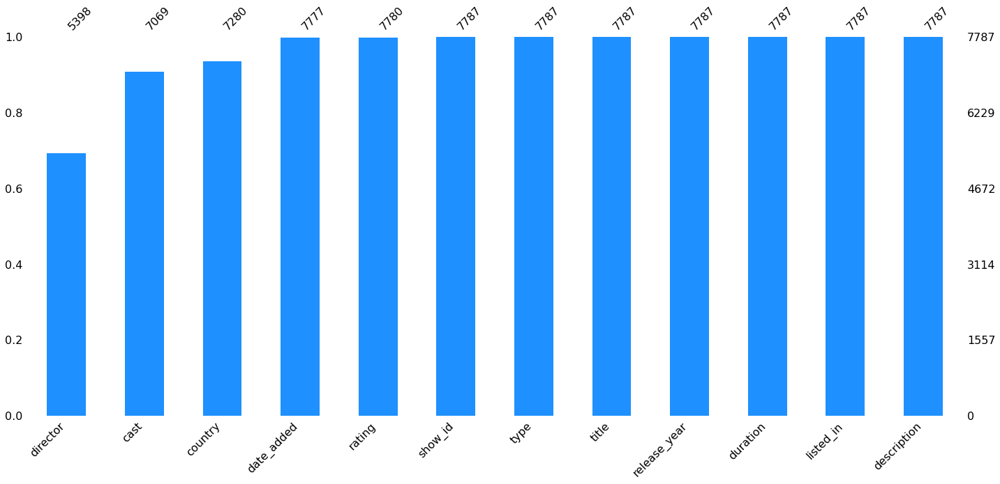

In [8]:
msno.bar(data,color='dodgerblue',sort='ascending')

#### DATA CLEANING
Now that we have a barchart representing the number of null values in all the columns, we can now proceed to cleaning the dataset

In [9]:
data.drop(['show_id'],axis=1,inplace=True)

<AxesSubplot:>

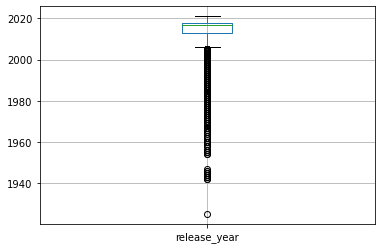

In [10]:
data.boxplot()

In [11]:
threshold=len(data)*0.1  # Taking 10% of the total rows as threshold to check if any column consists of null values less than the theshold no. of rows
threshold

778.7

In [12]:
data.dropna(thresh=threshold,axis=1,inplace=True)

In [13]:
data.isnull().sum()

type               0
title              0
director        2389
cast             718
country          507
date_added        10
release_year       0
rating             7
duration           0
listed_in          0
description        0
dtype: int64

In [14]:
data['rating'].value_counts()

TV-MA       2863
TV-14       1931
TV-PG        806
R            665
PG-13        386
TV-Y         280
TV-Y7        271
PG           247
TV-G         194
NR            84
G             39
TV-Y7-FV       6
UR             5
NC-17          3
Name: rating, dtype: int64

In [1]:
plt.figure(figsize=(8,5))
data['rating'].hist()

NameError: name 'plt' is not defined

In [16]:
data=data.fillna(data['rating'].value_counts().index[0])
data['rating'].isnull().sum()

0

In [17]:
dup=data[data.duplicated(['director','country'])]
print("Duplicated Rows of director and country: ")
print(dup)

Duplicated Rows of director and country: 
         type                                              title  \
29    TV Show                                           #blackAF   
32      Movie                                #FriendButMarried 2   
37      Movie                                         #Selfie 69   
38    TV Show                                แผนร้ายนายเจ้าเล่ห์   
53    TV Show                                         100 Humans   
55      Movie                100 Things to do Before High School   
58    TV Show                                        100% Hotter   
61    TV Show                                   12 Years Promise   
63    TV Show                                     13 Reasons Why   
64    TV Show                 13 Reasons Why: Beyond the Reasons   
67      Movie  13TH: A Conversation with Oprah Winfrey & Ava ...   
80    TV Show                                         20 Minutes   
81      Movie                                 2015 Dream Concert   
85    

In [18]:
data.drop(labels=['cast','director'],axis=1,inplace=True)

In [19]:
data.shape

(7787, 9)

In [20]:
data.dropna()

,type,title,country,date_added,release_year,rating,duration,listed_in,description
0,TV Show,3%,Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,Movie,7:19,Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,Movie,23:59,Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,Movie,9,United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,Movie,21,United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...
5,TV Show,46,Turkey,"July 1, 2017",2016,TV-MA,1 Season,"International TV Shows, TV Dramas, TV Mysteries",A genetics professor experiments with a treatm...
6,Movie,122,Egypt,"June 1, 2020",2019,TV-MA,95 min,"Horror Movies, International Movies","After an awful accident, a couple admitted to ..."
7,Movie,187,United States,"November 1, 2019",1997,R,119 min,Dramas,After one of his high school students attacks ...
8,Movie,706,India,"April 1, 2019",2019,TV-14,118 min,"Horror Movies, International Movies","When a doctor goes missing, his psychiatrist w..."
9,Movie,1920,India,"December 15, 2017",2008,TV-MA,143 min,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...


In [21]:
#grp1=data[(data['country']=='TV-MA') | (data['director']=='TV-MA') | (data['cast']=='TV-MA') |  (data['date_added']=='TV-MA')]
grp1=data[(data['country']=='TV-MA') |(data['date_added']=='TV-MA')]
ind1=list(grp1.index)

In [22]:
data.drop(labels=ind1,axis=0,inplace=True)
data.shape

(7271, 9)

In [23]:
data.head(10)

,type,title,country,date_added,release_year,rating,duration,listed_in,description
0,TV Show,3%,Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...
1,Movie,7:19,Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...
2,Movie,23:59,Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow..."
3,Movie,9,United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi..."
4,Movie,21,United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...
5,TV Show,46,Turkey,"July 1, 2017",2016,TV-MA,1 Season,"International TV Shows, TV Dramas, TV Mysteries",A genetics professor experiments with a treatm...
6,Movie,122,Egypt,"June 1, 2020",2019,TV-MA,95 min,"Horror Movies, International Movies","After an awful accident, a couple admitted to ..."
7,Movie,187,United States,"November 1, 2019",1997,R,119 min,Dramas,After one of his high school students attacks ...
8,Movie,706,India,"April 1, 2019",2019,TV-14,118 min,"Horror Movies, International Movies","When a doctor goes missing, his psychiatrist w..."
9,Movie,1920,India,"December 15, 2017",2008,TV-MA,143 min,"Horror Movies, International Movies, Thrillers",An architect and his wife move into a castle t...


In [24]:
data['Year_added']=data['date_added'].str.split(", ")
data['Year_added'][1][1]

'2016'

In [25]:
data['Year_added']=data['Year_added'].apply(lambda x: x[1])
data['Year_added']

0       2020
1       2016
2       2018
3       2017
4       2020
5       2017
6       2020
7       2019
8       2019
9       2017
10      2017
11      2018
12      2019
13      2019
14      2020
15      2019
17      2018
18      2019
19      2018
20      2018
21      2018
22      2018
23      2018
24      2020
25      2016
26      2020
27      2020
28      2020
29      2020
30      2020
31      2020
32      2020
33      2017
34      2019
35      2016
36      2019
37      2019
39      2019
40      2017
41      2018
42      2017
43      2020
44      2018
45      2017
46      2017
47      2017
48      2019
49      2017
50      2019
51      2020
52      2018
53      2020
54      2017
55      2019
56      2018
57      2021
58      2019
59      2016
60      2019
61      2017
62      2016
63      2020
64      2019
65      2019
66      2016
68      2019
69      2018
70      2019
71      2019
72      2021
73      2020
74      2017
75      2020
76      2019
77      2020
78      2018
79      2018

In [27]:
data['Year_added']
data.head()

,type,title,country,date_added,release_year,rating,duration,listed_in,description,Year_added
0,TV Show,3%,Brazil,"August 14, 2020",2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020
1,Movie,7:19,Mexico,"December 23, 2016",2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016
2,Movie,23:59,Singapore,"December 20, 2018",2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018
3,Movie,9,United States,"November 16, 2017",2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017
4,Movie,21,United States,"January 1, 2020",2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020


In [28]:
data.drop(['date_added'],axis=1,inplace=True)

In [29]:
data.head(5)

,type,title,country,release_year,rating,duration,listed_in,description,Year_added
0,TV Show,3%,Brazil,2020,TV-MA,4 Seasons,"International TV Shows, TV Dramas, TV Sci-Fi &...",In a future where the elite inhabit an island ...,2020
1,Movie,7:19,Mexico,2016,TV-MA,93 min,"Dramas, International Movies",After a devastating earthquake hits Mexico Cit...,2016
2,Movie,23:59,Singapore,2011,R,78 min,"Horror Movies, International Movies","When an army recruit is found dead, his fellow...",2018
3,Movie,9,United States,2009,PG-13,80 min,"Action & Adventure, Independent Movies, Sci-Fi...","In a postapocalyptic world, rag-doll robots hi...",2017
4,Movie,21,United States,2008,PG-13,123 min,Dramas,A brilliant group of students become card-coun...,2020


In [30]:
data['category']=data['listed_in'].apply(lambda x:x.split(',') if ", " in x else x)
#data['Category']=pd.get_dummies(data['Category'],drop_first=True)
data['category']

0       [International TV Shows,  TV Dramas,  TV Sci-F...
1                         [Dramas,  International Movies]
2                  [Horror Movies,  International Movies]
3       [Action & Adventure,  Independent Movies,  Sci...
4                                                  Dramas
5       [International TV Shows,  TV Dramas,  TV Myste...
6                  [Horror Movies,  International Movies]
7                                                  Dramas
8                  [Horror Movies,  International Movies]
9       [Horror Movies,  International Movies,  Thrill...
10                                   [Dramas,  Thrillers]
11      [Crime TV Shows,  International TV Shows,  TV ...
12      [Crime TV Shows,  Docuseries,  International T...
13      [Documentaries,  International Movies,  Sports...
14      [Independent Movies,  Sci-Fi & Fantasy,  Thril...
15            [Dramas,  International Movies,  Thrillers]
17                                   [Dramas,  Thrillers]
18            

In [31]:
type(data['category'])

pandas.core.series.Series

In [32]:
len(data['category'])

7271

In [33]:
data.reset_index(drop=False,inplace=True)

##### Segregating listed_in column into Category and Genre

In [34]:
subs=['International Movies','Independent Movies','Documentaries','International TV Shows','Independent TV Shows','Docuseries']

In [35]:
def gen(y):
    g=[]
    if isinstance(y,list):
        for i in range (0,len(y)):
            y[i]=y[i].lstrip()
            if(y[i] in subs):
                continue;
        
            if(y[i] not in subs):
                g.append(y[i])
                continue;
        return g;
    elif (y in subs):
        return None;
    elif (y not in subs):
        return y;  
    else:
        return None

In [36]:
data['Genre']=data['category'].apply(gen)

In [37]:
def cat(x):
   
    if isinstance(x,list):  # To check if 'x' is a list
        for i in range (0,len(x)):
            x[i]=x[i].lstrip()
            if(x[i] in subs):
                break;
            if(x[i] not in subs):
                x[i]=None
        return(x[i]);
    elif (x in subs):
        return x;
    else:
        return (None)


In [38]:
data['Category']=data['category'].apply(cat)

In [40]:
data.columns=['index', 'Type', 'Title', 'Country', 'release_year',
       'Rating', 'Duration', 'listed_in', 'Description', 'Year_added',
       'category', 'Genre', 'Category']

In [41]:
data.columns

Index(['index', 'Type', 'Title', 'Country', 'release_year', 'Rating',
       'Duration', 'listed_in', 'Description', 'Year_added', 'category',
       'Genre', 'Category'],
      dtype='object')

In [42]:
data['Category'].mode()
data['Genre'].mode()

0    [Dramas]
dtype: object

In [43]:
data['Category'].fillna(str(data['Category'].mode().values[0]), inplace=True)
data['Genre'].fillna(str(data['Genre'].explode().mode().values[0]), inplace=True)

In [44]:
data.drop(labels=['release_year','listed_in','category'],axis=1,inplace=True)

In [45]:
data.isnull().sum()

index          0
Type           0
Title          0
Country        0
Rating         0
Duration       0
Description    0
Year_added     0
Genre          0
Category       0
dtype: int64

In [46]:
data.drop(['index'],axis=1,index=None)

,Type,Title,Country,Rating,Duration,Description,Year_added,Genre,Category
0,TV Show,3%,Brazil,TV-MA,4 Seasons,In a future where the elite inhabit an island ...,2020,"[TV Dramas, TV Sci-Fi & Fantasy]",International TV Shows
1,Movie,7:19,Mexico,TV-MA,93 min,After a devastating earthquake hits Mexico Cit...,2016,[Dramas],International Movies
2,Movie,23:59,Singapore,R,78 min,"When an army recruit is found dead, his fellow...",2018,[Horror Movies],International Movies
3,Movie,9,United States,PG-13,80 min,"In a postapocalyptic world, rag-doll robots hi...",2017,"[Action & Adventure, Sci-Fi & Fantasy]",Independent Movies
4,Movie,21,United States,PG-13,123 min,A brilliant group of students become card-coun...,2020,Dramas,International Movies
5,TV Show,46,Turkey,TV-MA,1 Season,A genetics professor experiments with a treatm...,2017,"[TV Dramas, TV Mysteries]",International TV Shows
6,Movie,122,Egypt,TV-MA,95 min,"After an awful accident, a couple admitted to ...",2020,[Horror Movies],International Movies
7,Movie,187,United States,R,119 min,After one of his high school students attacks ...,2019,Dramas,International Movies
8,Movie,706,India,TV-14,118 min,"When a doctor goes missing, his psychiatrist w...",2019,[Horror Movies],International Movies
9,Movie,1920,India,TV-MA,143 min,An architect and his wife move into a castle t...,2017,"[Horror Movies, Thrillers]",International Movies


#### DATA VISUALIZATION

1. Check the number of Movies and TV Shows in the given dataset 

E:\Jupyter Anaconda 2021\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Type', ylabel='count'>

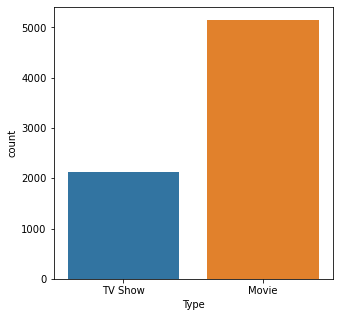

In [47]:
plt.figure(figsize=(5,5))
sns.countplot(data['Type'])

2. Check the Number of Movies and TV shows added Year wise

<AxesSubplot:xlabel='Type', ylabel='count'>

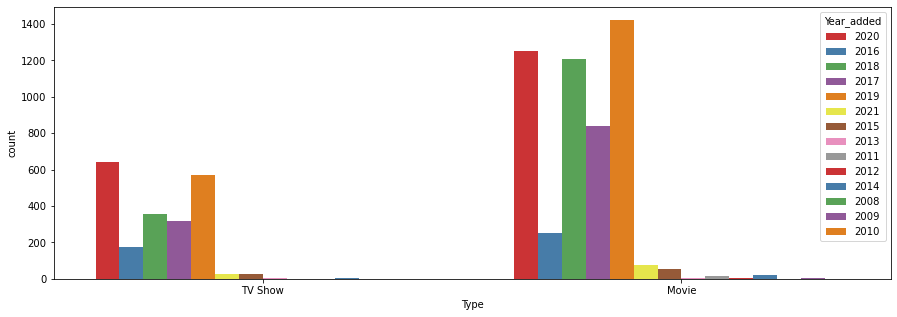

In [57]:
plt.figure(figsize=(15,5))
sns.countplot(data=data,x='Type',hue='Year_added',palette='Set1')

3. Number of content rating wise

<AxesSubplot:xlabel='Rating', ylabel='count'>

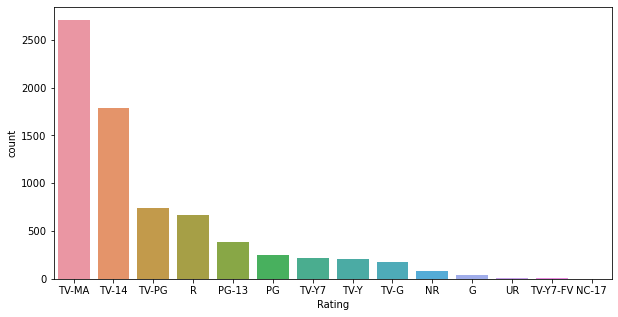

In [50]:
plt.figure(figsize=(10,5))
sns.countplot(data=data,x='Rating',order=data['Rating'].value_counts().index)

In [65]:
exg=data['Genre'].explode().value_counts()
exc=data['Category'].explode().value_counts()

4. Different Genres that are available

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36]),
 [Text(0, 0, 'Dramas'),
  Text(1, 0, 'Comedies'),
  Text(2, 0, 'Action & Adventure'),
  Text(3, 0, 'TV Dramas'),
  Text(4, 0, 'Romantic Movies'),
  Text(5, 0, 'Thrillers'),
  Text(6, 0, 'Children & Family Movies'),
  Text(7, 0, 'TV Comedies'),
  Text(8, 0, 'Crime TV Shows'),
  Text(9, 0, "Kids' TV"),
  Text(10, 0, 'Horror Movies'),
  Text(11, 0, 'Stand-Up Comedy'),
  Text(12, 0, 'Music & Musicals'),
  Text(13, 0, 'Romantic TV Shows'),
  Text(14, 0, 'British TV Shows'),
  Text(15, 0, 'Sci-Fi & Fantasy'),
  Text(16, 0, 'Reality TV'),
  Text(17, 0, 'Sports Movies'),
  Text(18, 0, 'TV Action & Adventure'),
  Text(19, 0, 'Anime Series'),
  Text(20, 0, 'Korean TV Shows'),
  Text(21, 0, 'Spanish-Language TV Shows'),
  Text(22, 0, 'Classic Movies'),
  Text(23, 0, 'TV Mysteries'),
  Text(24, 0, 'LGBTQ Movies'),
  Text(25, 0

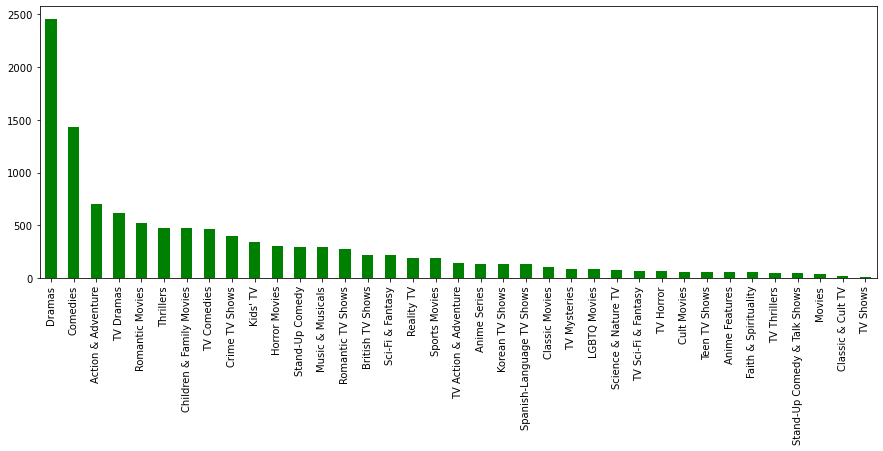

In [67]:
plt.figure(figsize=(15,5))
exg.plot(kind='bar',orientation='vertical',color='green')
plt.xticks(rotation=90)

5. Various categories of shows or Movies available

(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'International Movies'),
  Text(1, 0, 'International TV Shows'),
  Text(2, 0, 'Documentaries'),
  Text(3, 0, 'Independent Movies'),
  Text(4, 0, 'Docuseries')])

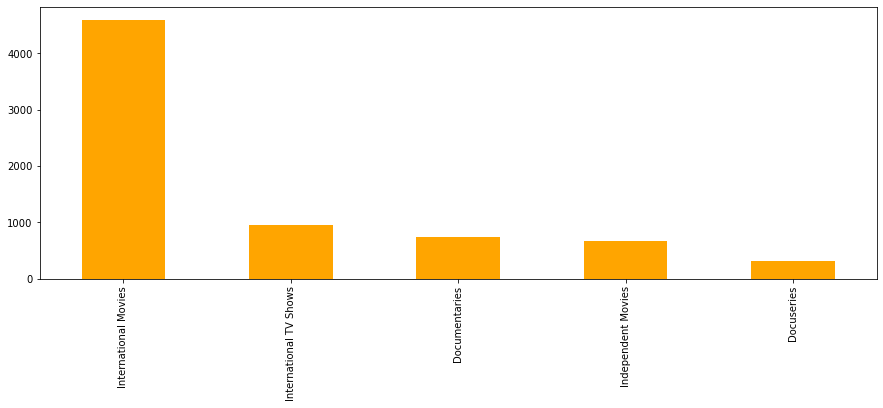

In [64]:
plt.figure(figsize=(15,5))
exc.plot(kind='bar',color='orange')
plt.xticks(rotation=90)

In [54]:
data['Country']=data['Country'].apply(lambda x:x.split(', ') if (", ") in x else x)
#excnt=data['Country'].explode().value_counts()
excnt=data['Country'].explode().value_counts()
excnt.drop_duplicates(keep='first', inplace=True)

6. Content available country-wise

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
 [Text(0, 0, 'United States'),
  Text(1, 0, 'India'),
  Text(2, 0, 'United Kingdom'),
  Text(3, 0, 'Canada'),
  Text(4, 0, 'France'),
  Text(5, 0, 'Japan'),
  Text(6, 0, 'Spain'),
  Text(7, 0, 'South Korea'),
  Text(8, 0, 'Germany'),
  Text(9, 0, 'Mexico'),
  Text(10, 0, 'China'),
  Text(11, 0, 'Australia'),
  Text(12, 0, 'Egypt'),
  Text(13, 0, 'Turkey'),
  Text(14, 0, 'Hong Kong'),
  Text(15, 0, 'Italy'),
  Text(16, 0, 'Brazil'),
  Text(17, 0, 'Taiwan'),
  Text(18, 0, 'Argentina'),
  Text(19, 0, 'Indonesia'),
  Text(20, 0, 'Philippines'),
  Text(21, 0, 'Nigeria'),
  Text(22, 0, 'Thailand'),
  Text(23, 0, 'South Africa'),
  Text(24, 0, 'Netherlands'),
  Text(25, 0, 'Denmark'),
  Text(26, 0, 'Ireland'),
  Text(27, 0, 'Sweden'),
  Text(28, 0, 'Poland'),
  Text(29, 

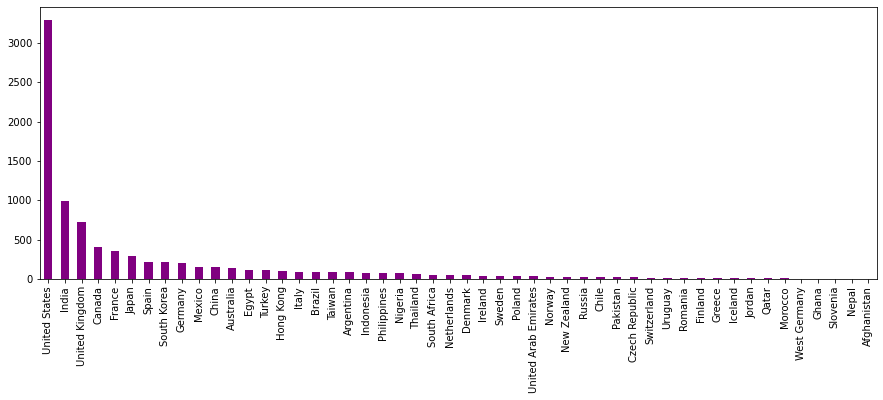

In [68]:
plt.figure(figsize=(15,5))
excnt.plot(kind='bar',color='purple')
plt.xticks(rotation=90)